<a href="https://colab.research.google.com/github/strugglinStudent/tpgit/blob/main/tp1av.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### TP1 : Chargement d’une vidéo avec OpenCV et

## Segmentation spatiale/temporelle

In [20]:
!pip install opencv-python
!apt-get -qq install -y graphviz && pip install pydot
!pip install matplotlib
import pydot

monter sur drive

In [6]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


## I. Acquisition Chargement et Sauvegarde

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
video = cv2.VideoCapture('/content/drive/MyDrive/folder/vid.mp4')

Trouvez la fonction adéquate et affichez les informations relatives à la vidéo : hauteur, largeur, nombre de frames, et fps(frame per second)

In [ ]:
(major_ver, minor_ver, subminor_ver) = (cv2.__version__).split('.')
fps = video.get(cv2.CAP_PROP_FPS)
n_frames = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))

print('fps:', round(fps, 2))
print('n_frames: ', n_frames)
print('height: ', height)
print('width: ', width)

fps: 30.0
n_frames:  223
height:  640
width:  368


Utilisez la fonction read pour extraire les frames de votre vidéo. Ensuite, sauvegardezles dans le dossier de travail à l’aide de la fonction imwrite (ajoutez quelques frames avec numéro à votre rapport)

In [ ]:
from google.colab import drive
import cv2

# Specify the path to the folder in Google Drive
output_folder_path = '/content/drive/MyDrive/folder/'

# Create the output folder if it doesn't exist
import os
os.makedirs(output_folder_path, exist_ok=True)

# Rest of your code (reading frames and saving them)
frame_num = 0

while True:
    ret, frame = video.read()
    if not ret:
        break

    frame_filename = f"{output_folder_path}frame_{frame_num}.jpg"
    cv2.imwrite(frame_filename, frame)

    frame_num += 1

# Release the video
video.release()


ensuite, affichez un frame toutes les 50ms à l’aide de imshow (pensez à créer une boucle while
qui s’arrête quand il n’y a plus de frames à afficher)

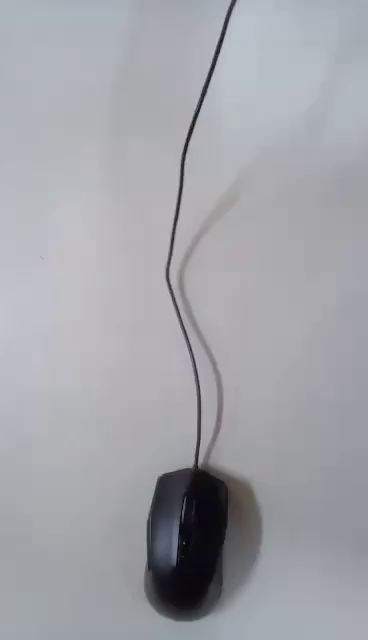

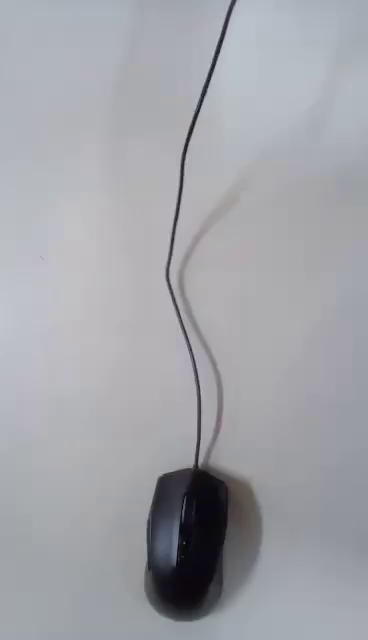

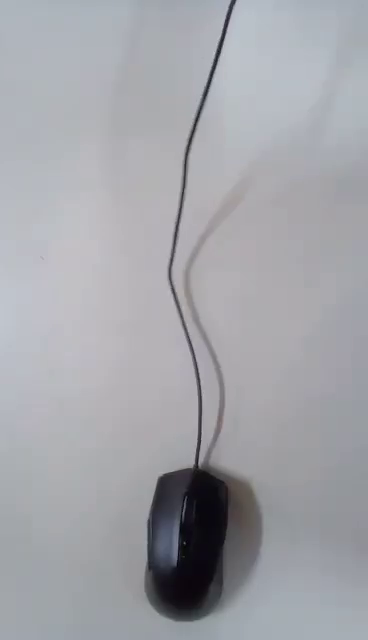

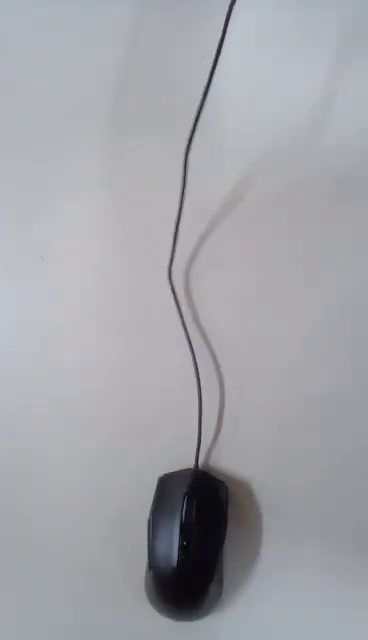

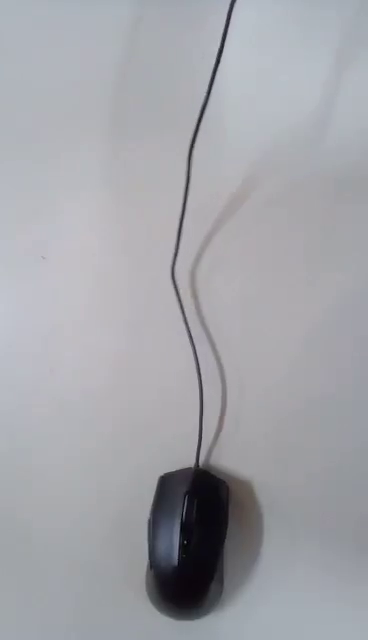

...

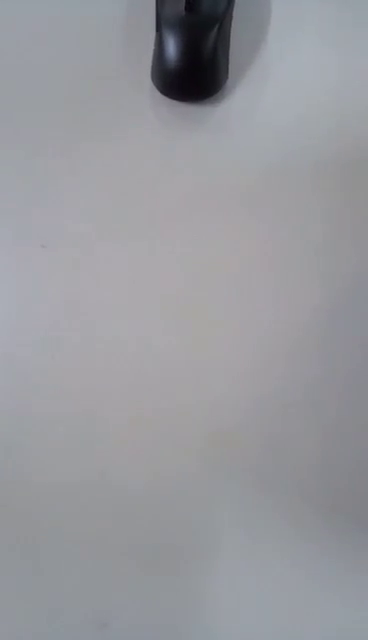

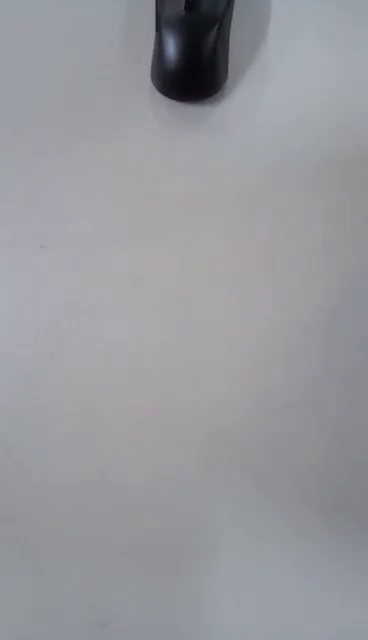

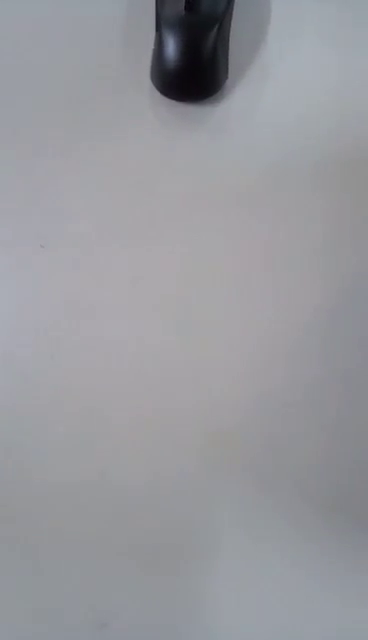

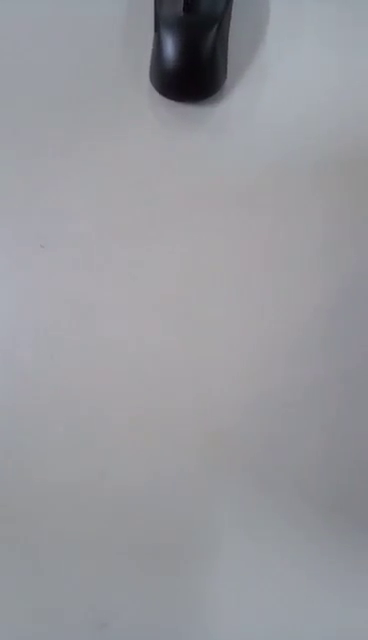

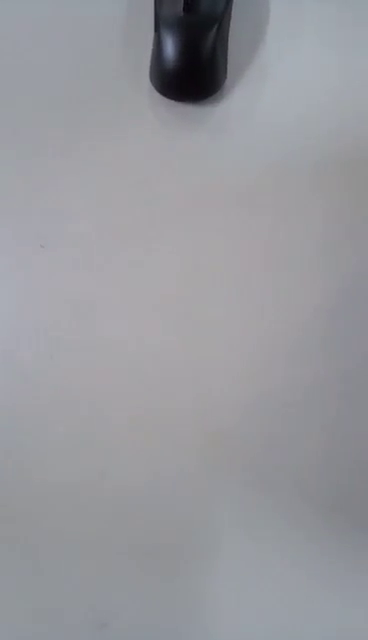

In [ ]:
import cv2
from google.colab.patches import cv2_imshow  # Import cv2_imshow for displaying frames
video = cv2.VideoCapture('/content/drive/MyDrive/folder/vid.mp4')
# Vérifier si la vidéo a été correctement chargée
if not video.isOpened():
    print("Erreur lors du chargement de la vidéo.")

else:
    while True:
        ret, frame = video.read()
        if not ret:
            break

        # Afficher le frame
        cv2_imshow(frame)  # Utilisez cv2_imshow à la place de cv2.imshow

        # Attendre 50 ms (0 signifie que la fenêtre restera ouverte jusqu'à ce qu'elle soit fermée par l'utilisateur)
        if cv2.waitKey(50) & 0xFF == 27:  # Attendre 50 ms ou jusqu'à ce que la touche Échap (ESC) soit pressée
            break

# Libérer la vidéo
video.release()



In [ ]:
# Fermer toutes les fenêtres
cv2.destroyAllWindows()

# Libérer la vidéo
video.release()

# **Segmentation spatiale: Conversion et seuillage**
Reprendre avec la vidéo que vous venez de créer : On veut maintenant lire cette vidéo frame par frame et convertir ces frames de RGB aux niveaux de gris. Pour cela, vous devrez utiliser la fonction cvtColor.

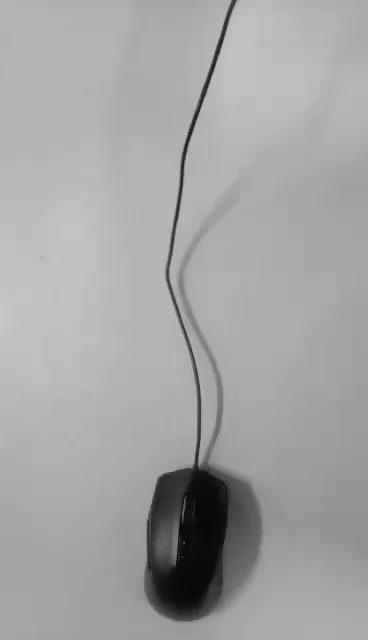

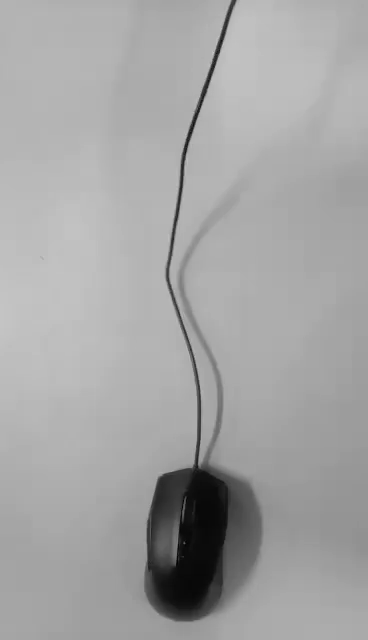

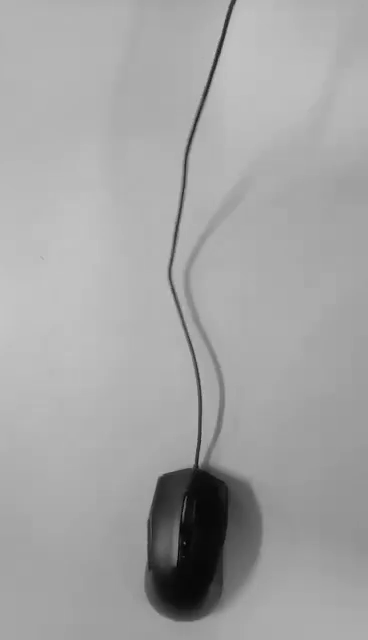

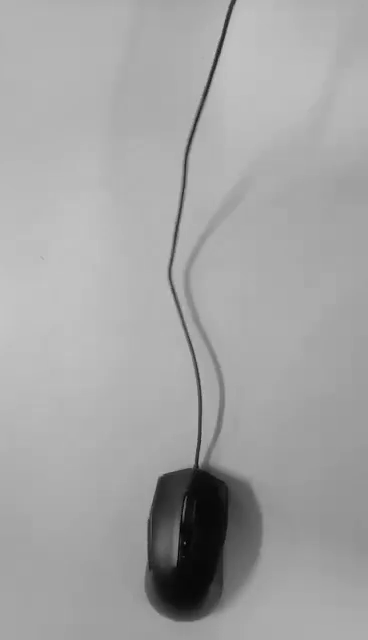

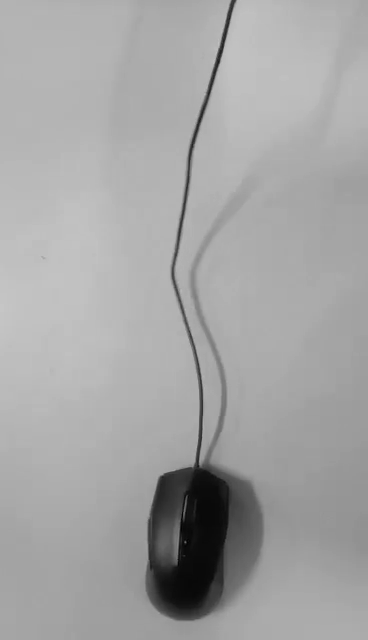

...

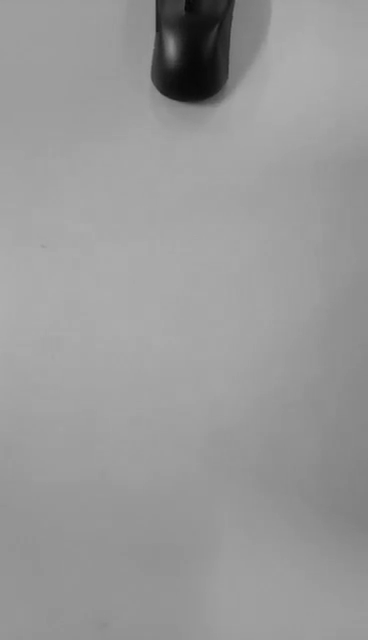

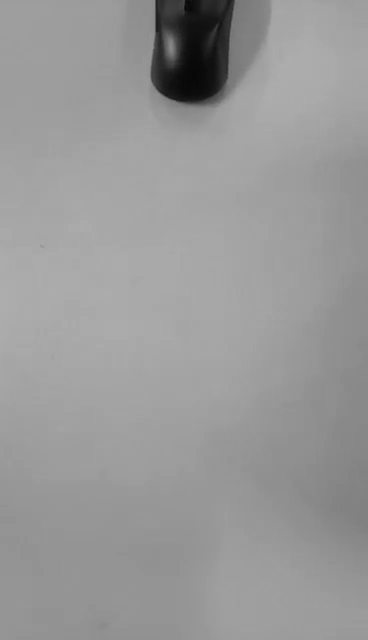

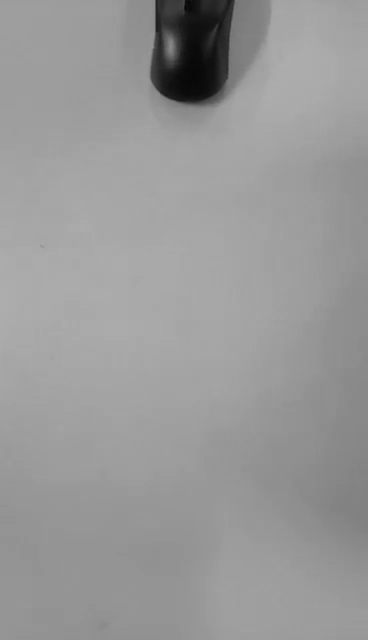

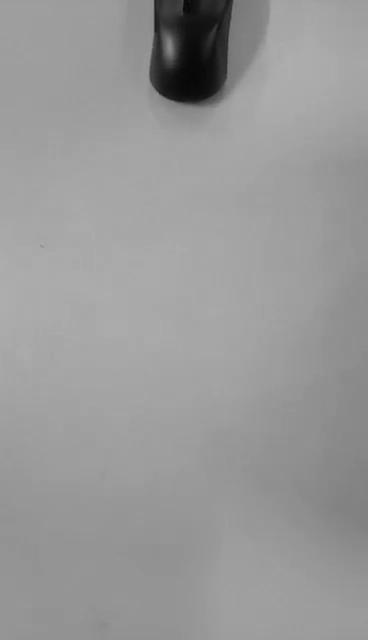

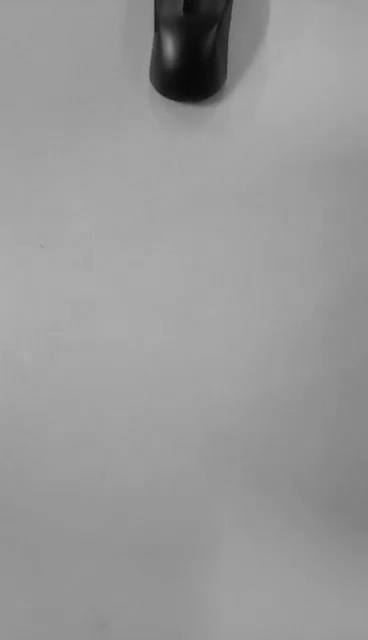

In [ ]:
import cv2
from google.colab.patches import cv2_imshow  # Import cv2_imshow for displaying frames
video = cv2.VideoCapture('/content/drive/MyDrive/folder/vid.mp4')

# Vérifier si la vidéo a été correctement chargée
if not video.isOpened():
    print("Erreur lors du chargement de la vidéo.")
else:
    while True:
        ret, frame = video.read()
        if not ret:
            break

        # Convertir le frame de RGB à niveaux de gris
        gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Afficher le frame en niveaux de gris
        cv2_imshow(gray_frame)  # Utilisez cv2_imshow à la place de cv2.imshow

        # Attendre 50 ms (0 signifie que la fenêtre restera ouverte jusqu'à ce qu'elle soit fermée par l'utilisateur)
        if cv2.waitKey(50) & 0xFF == 27:  # Attendre 50 ms ou jusqu'à ce que la touche Échap (ESC) soit pressée
            break

    # Libérer la vidéo
    video.release()


on utilise un algorithme de seuillage global heuristique pour binariser le frame en fonction d'un seuil. L'algorithme itère jusqu'à ce que le seuil converge, ce qui signifie que le seuil ne change que très peu entre les itérations.

Le frame est binarisé en utilisant le seuil final calculé, où les pixels en dessous du seuil sont définis à 0 (noir) et les pixels au-dessus du seuil sont définis à 255 (blanc).

L'image binaire résultante est affichée à l'aide de cv2_imshow, ce qui vous permet de voir le résultat de la binarisation.

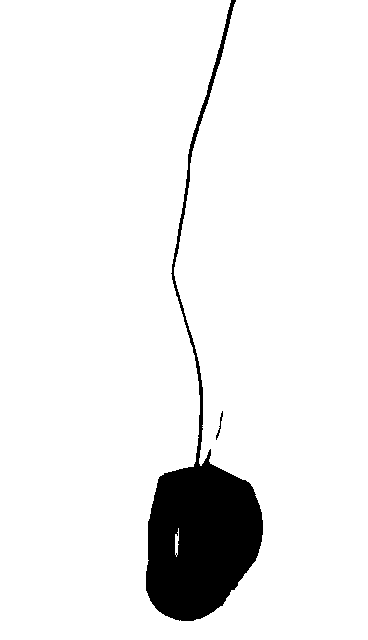

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

video = cv2.VideoCapture('/content/drive/MyDrive/folder/vid.mp4')
# Lire le frame d'intérêt
frame_num_of_interest = 5  # Numéro du frame d'intérêt
video.set(cv2.CAP_PROP_POS_FRAMES, frame_num_of_interest)
ret, frame = video.read()
if not ret:
  print("Impossible de lire le frame. Assurez-vous que la vidéo a été ouverte correctement.")

# Convertir le frame en niveaux de gris
gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

# Algorithme de seuillage global heuristique
T = 128  # Valeur de seuil initiale
delta_T = 1  # Différence minimale pour la convergence
while True:
    class1 = gray_frame[gray_frame <= T]
    class2 = gray_frame[gray_frame > T]

    mean1 = np.mean(class1)
    mean2 = np.mean(class2)

    new_T = (mean1 + mean2) // 2

    if abs(T - new_T) < delta_T:
        break

    T = new_T

# Binarisation de l'image en utilisant le seuil final T
binary_frame = gray_frame.copy()
binary_frame[binary_frame <= T] = 0
binary_frame[binary_frame > T] = 255

# Afficher l'image binaire
cv2_imshow(binary_frame)

# Libérer la vidéo
video.release()


on applique*** la méthode d'Otsu*** pour segmenter le frame en deux classes : une classe de premier plan (objets) et une classe d'arrière-plan.

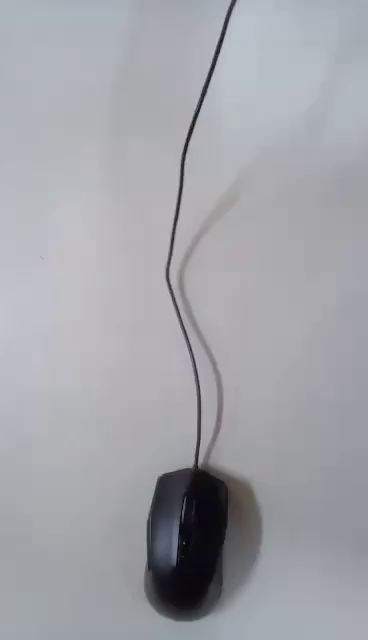

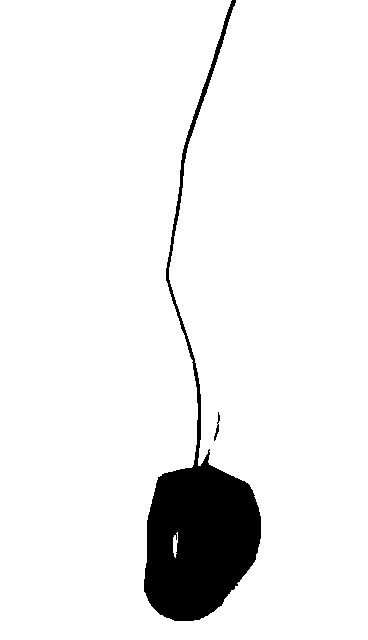

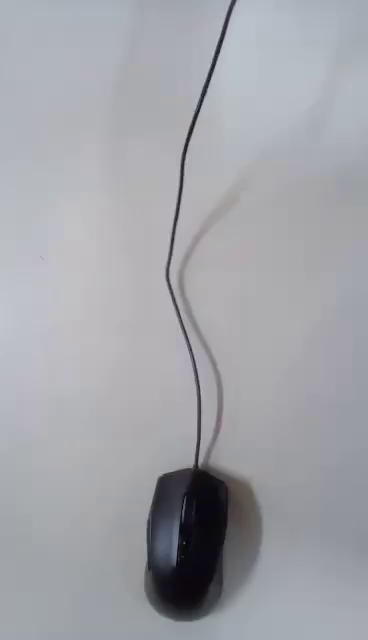

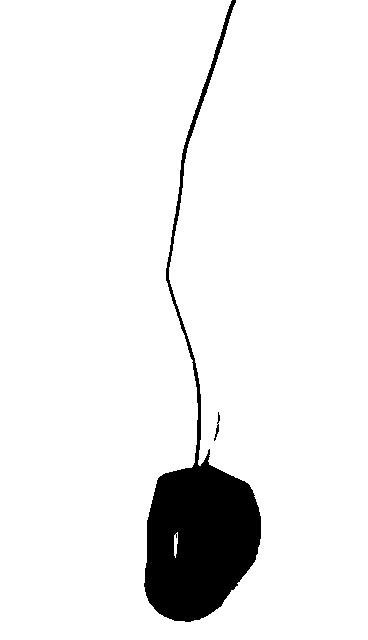

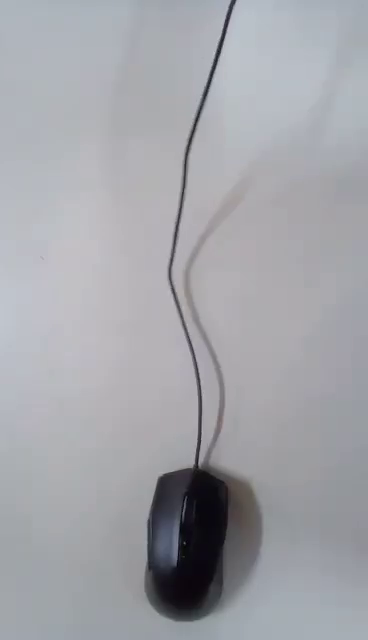

...

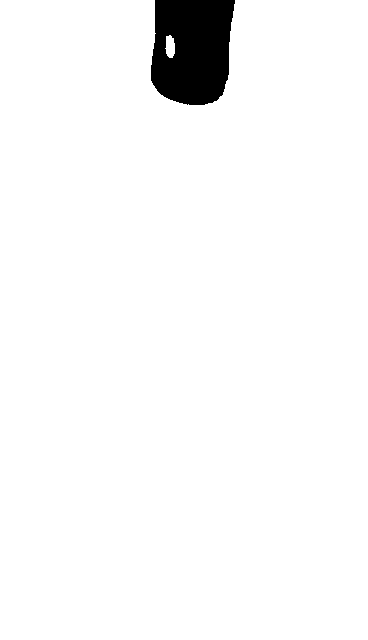

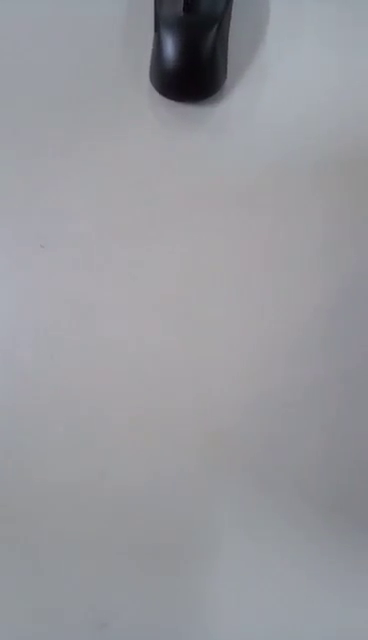

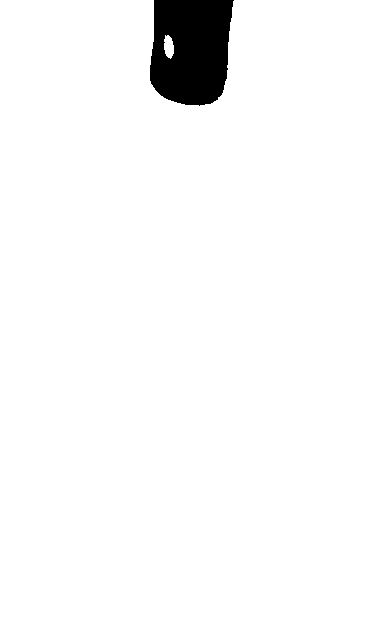

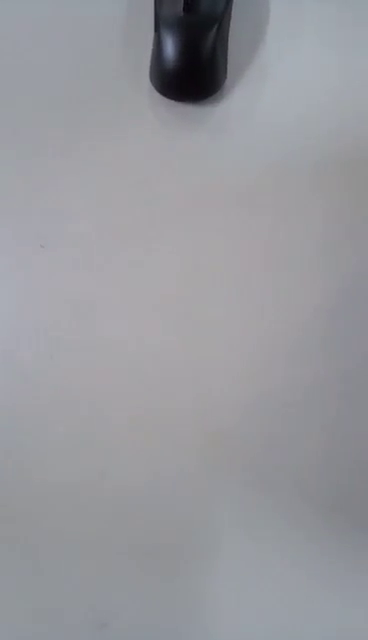

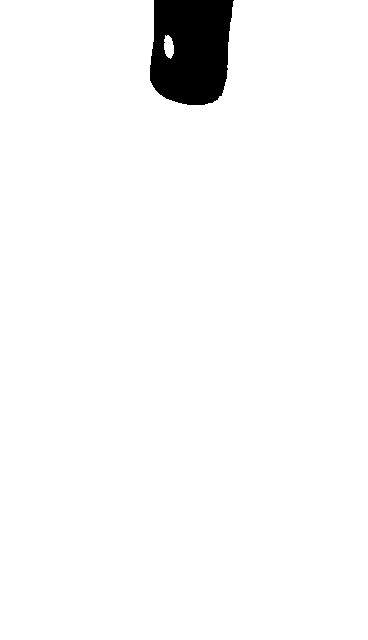

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
video = cv2.VideoCapture('/content/drive/MyDrive/folder/vid.mp4')
# Vérifier si la vidéo a été correctement chargée
if not video.isOpened():
    print("Erreur lors du chargement de la vidéo.")
else:
    # Obtenir les propriétés de la vidéo (largeur, hauteur, FPS)
    width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = int(video.get(cv2.CAP_PROP_FPS))

    # Créer un objet VideoWriter pour enregistrer la vidéo segmentée
    fourcc = cv2.VideoWriter_fourcc(*'XVID')
    segmented_video = cv2.VideoWriter('segmented_video.avi', fourcc, fps, (width, height), isColor=False)

    while True:
        ret, frame = video.read()
        if not ret:
            break

        # Convertir le frame en niveaux de gris
        gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

        # Appliquer la méthode d'Otsu pour la segmentation
        _, segmented_frame = cv2.threshold(gray_frame, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

        # Afficher la vidéo d'origine dans une fenêtre
        cv2_imshow(frame)

        # Afficher la vidéo segmentée dans une autre fenêtre
        cv2_imshow(segmented_frame)

        # Enregistrer la frame segmentée dans la vidéo de sortie
        segmented_video.write(segmented_frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # Libérer les vidéos
    video.release()
    segmented_video.release()

# Fermer toutes les fenêtres
cv2.destroyAllWindows()


### III. Segmentation temporelle
1-n converti Chaque frameen niveaux de gris, soustract l'arrière-plan en calculant la différence absolue entre le frame actuel et l'image de fond.

L'image de différence est ensuite binarisée en utilisant le seuil défini.

Les contours des objets en mouvement sont trouvés dans l'image binaire de différence.

L'image de fond est mise à jour en utilisant une moyenne pondérée entre l'image de fond actuelle et le frame actuel. Le facteur de mise à jour est contrôlé par la variable lamda.

en cas d'une motion tres lent. les contours sont presque invisible avec un seuil 0.1:


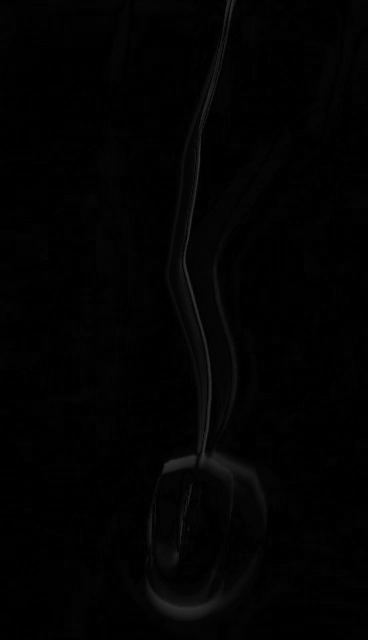

ci-dessous en remarque que la méthode de base pour estimer l’image de fond n'est pas rendante, il y d'ambiguité encore on augmentant seuil a 0.8 la segmentation est plus encore flou on voir que le fils de souris mais pas la souris elle meme. donc seuil reste 0.5 pour cette exercice

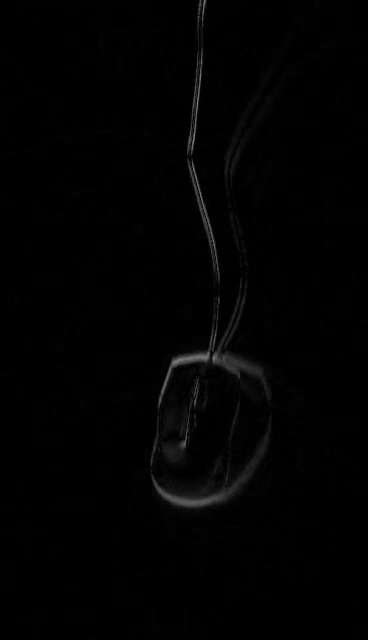

et pour un motion vite on remarque qu'il est detruit:

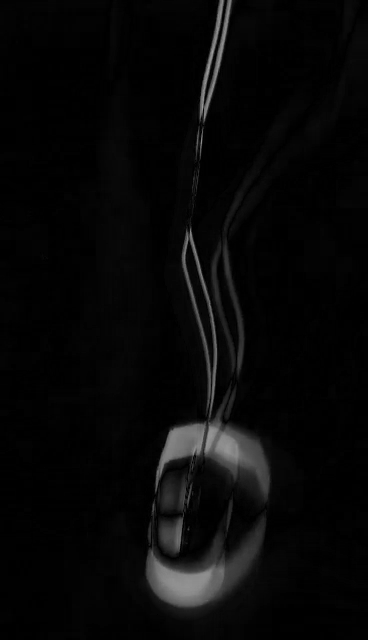

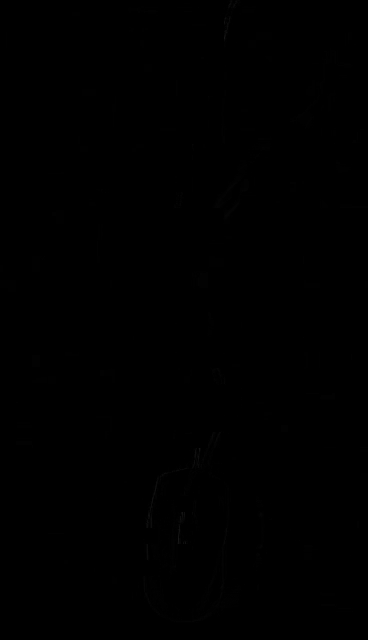

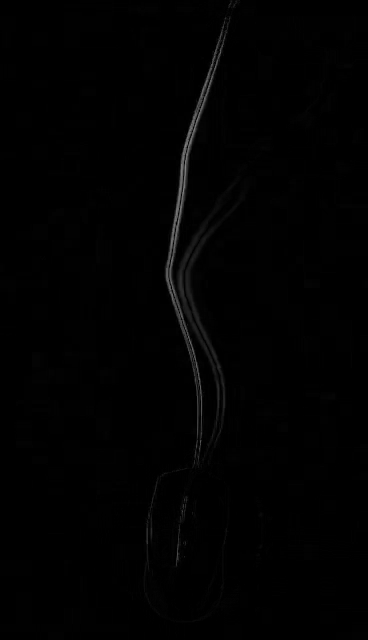

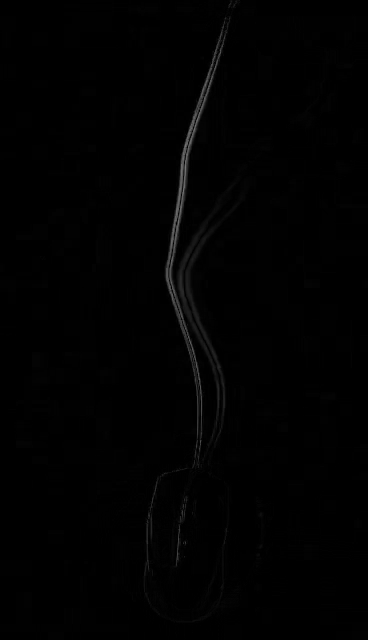

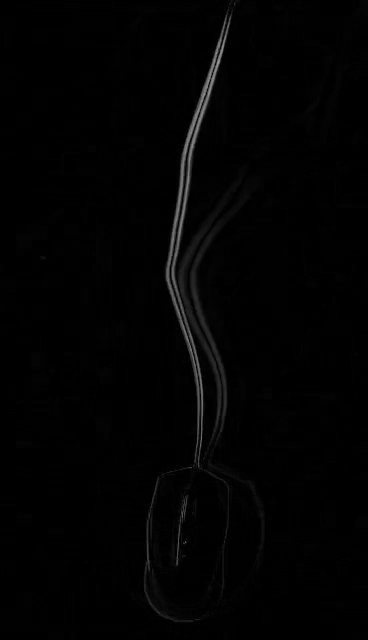

...

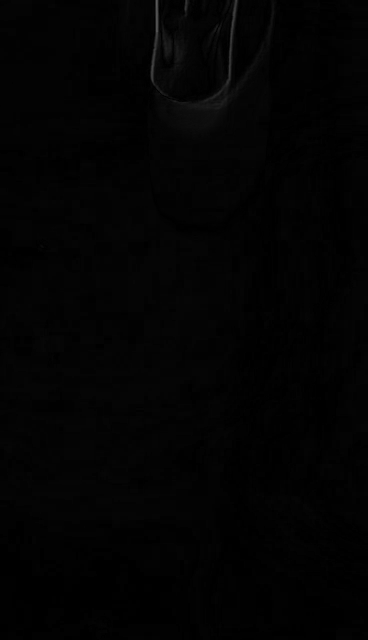

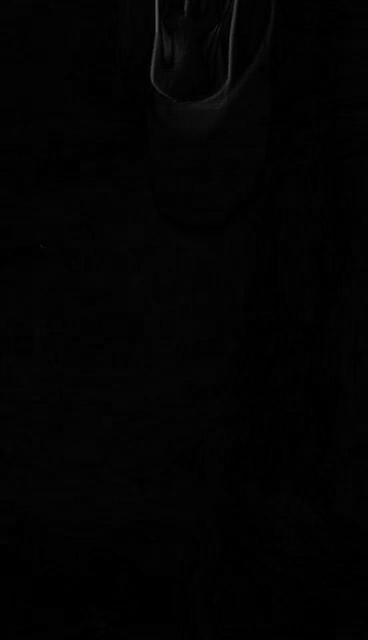

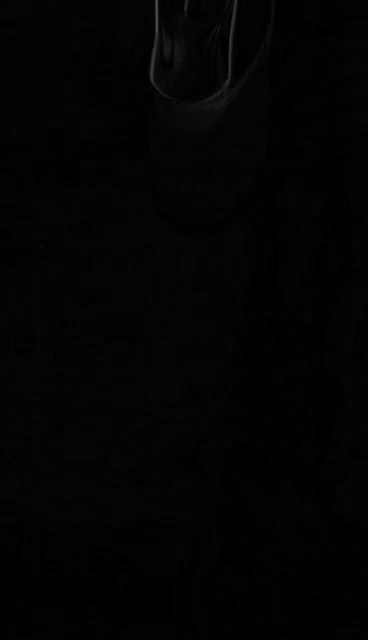

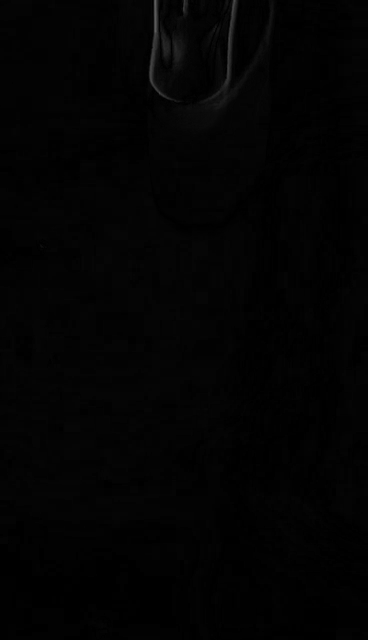

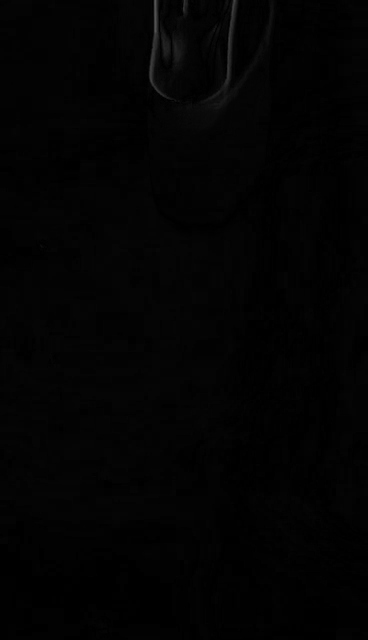

In [ ]:
#1 soustraire de fond
import cv2
from google.colab.patches import cv2_imshow
video = cv2.VideoCapture('/content/drive/MyDrive/folder/vid.mp4')
# Lire le premier frame pour initialiser l'image de fond
ret, background = video.read()
if not ret:
    print("Impossible de lire le frame initial.")
    exit()
# Convertir l'image de fond en niveaux de gris
background_gray = cv2.cvtColor(background, cv2.COLOR_BGR2GRAY)

# Définir un seuil pour la détection d'objet en mouvement
threshold = 30

while True:
    ret, frame = video.read()
    if not ret:
        break

    # Convertir le frame en niveaux de gris
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Soustraction d'arrière-plan : |frame - background|
    frame_diff = cv2.absdiff(frame_gray, background_gray)

    # Binarisation de l'image différence
    _, binary_diff = cv2.threshold(frame_diff, threshold, 255, cv2.THRESH_BINARY)

      # Afficher le frame résultant de la soustraction d'images
    cv2_imshow(frame_diff)

    # Mettre à jour l'image de fond (moyenne pondérée)
    lamda = 0.1  # Facteur de mise à jour
    background_gray = cv2.addWeighted(background_gray, 1 - lamda, frame_gray, lamda, 0)

    if cv2.waitKey(30) & 0xFF == 27:  # Attendre 30 ms, si la touche 'ESC' est enfoncée, sortir de la boucle
        break

# Libérer la vidéo et fermer les fenêtres
video.release()
cv2.destroyAllWindows()


ci-dessus en remarque que la méthode
de base pour estimer l’image de fond n'est pas rendante, il y d'ambiguité encore on augmentant lamda a 0.8 la segmentation est plus encore flou on voir que le fils de souris mais pas la souris elle meme. donc lamda reste 0.1 pour cette exercice

2- on adapte un N  en fonction du frame rate de notre
caméra et de la vitesse de mouvement de votre objet.
il est remarquable que c'est mieu mais le effet ghost est bien present avec n=30 donc on choisi 15 pour cette exercice. les zone noir de souris ne sont pas detectable car du frame a frame ils ne change pas. aussi a un t donne on remarque que la vitesse se change d'ou le frame est plus ilisible car la vitesse change

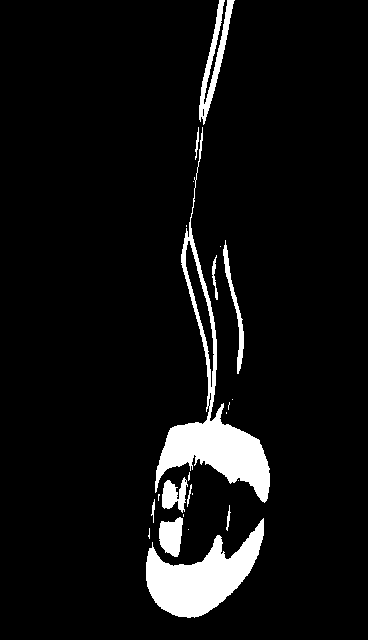

la souris disparus completemet pour 15 a un motion lent au debut:



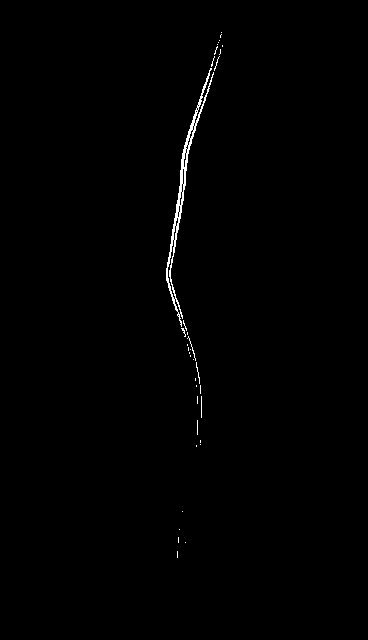

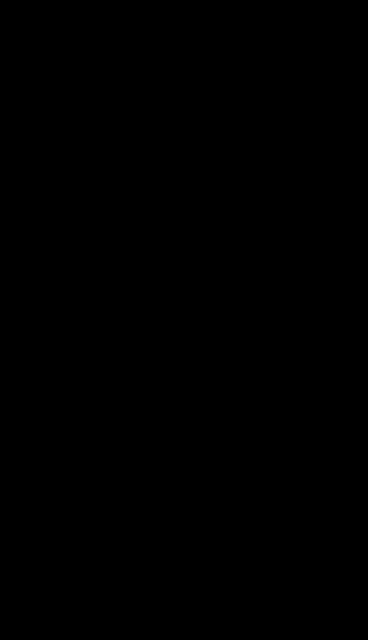

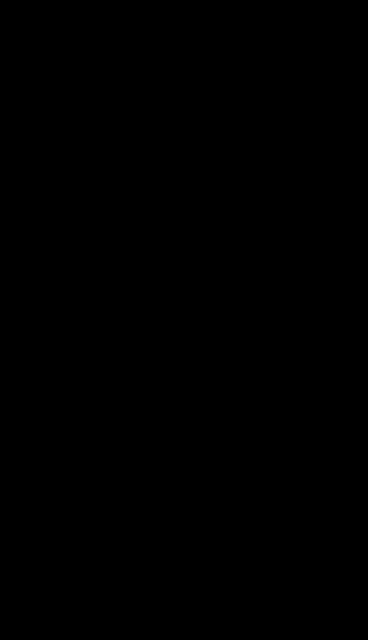

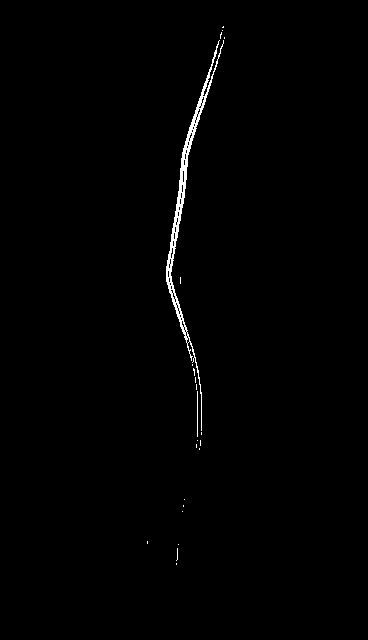

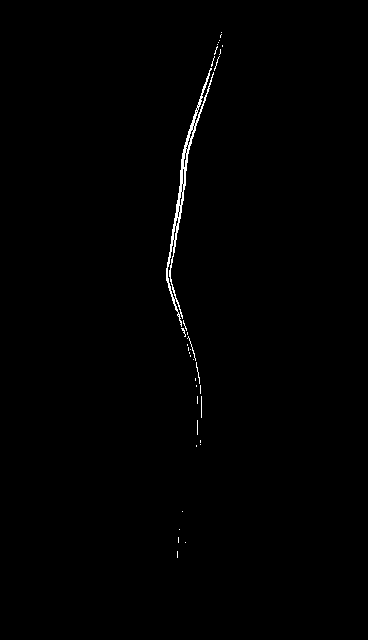

...

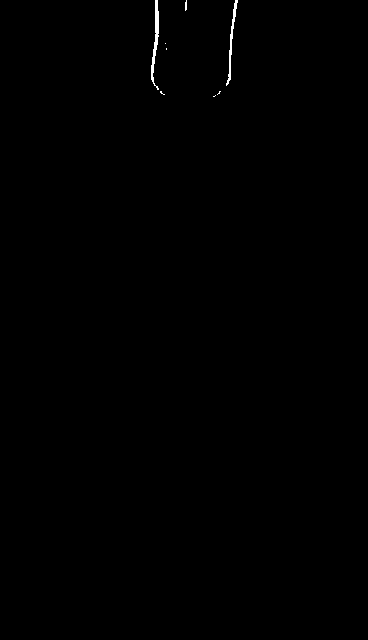

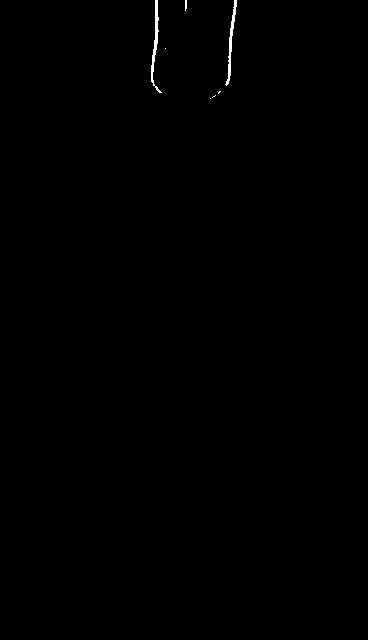

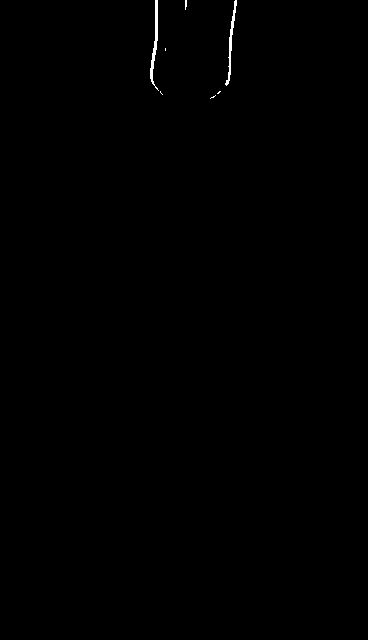

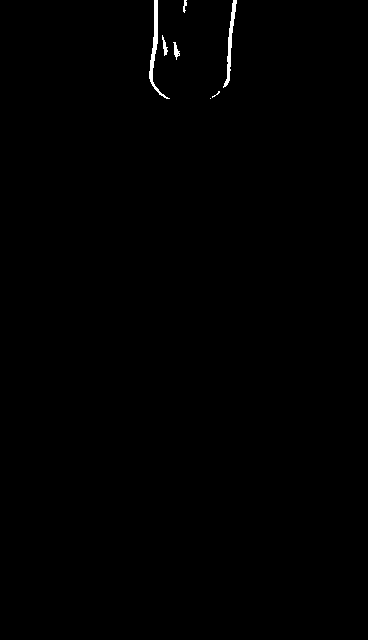

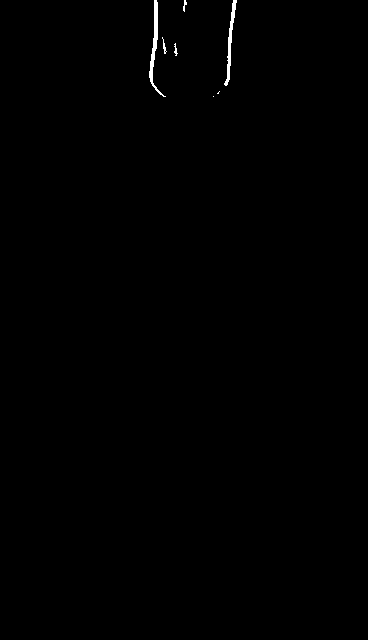

In [ ]:
#pour t-n

import cv2
import numpy as np

# Open the video
video = cv2.VideoCapture('/content/drive/MyDrive/folder/vid.mp4')

# Number of frames to use for differentiation
n_frames = 15

# Initialize the background as an empty list of frames
background_frames = []

while True:
    ret, frame = video.read()
    if not ret:
        break

    # Convert the frame to grayscale
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Append the current frame to the list of background frames
    background_frames.append(frame_gray)

    # If the list exceeds the specified number of frames, remove the oldest frame
    if len(background_frames) > n_frames:
        background_frames.pop(0)

    # Calculate the background as the average of the last n frames
    background_gray = np.mean(background_frames, axis=0).astype(np.uint8)

    # Set a threshold for motion detection
    threshold = 30

    # Calculate the absolute difference between the current frame and the background
    frame_diff = cv2.absdiff(frame_gray, background_gray)

    # Binarize the difference image
    _, binary_diff = cv2.threshold(frame_diff, threshold, 255, cv2.THRESH_BINARY)

    # Find contours in the binary difference image
    contours, _ = cv2.findContours(binary_diff, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)


    # Display the frame with motion regions
    cv2_imshow(binary_diff)

    if cv2.waitKey(30) & 0xFF == 27:  # Wait for 30 ms, if 'ESC' key is pressed, exit the loop
        break

# Release the video and close windows
video.release()
cv2.destroyAllWindows()


dans cette segmentation le fils n"est plus tenu compte pour presque la totalite du temps c'est pourquoi elle notre meilleur choix.

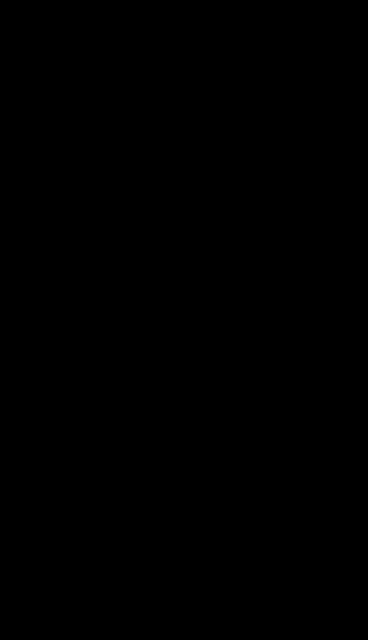

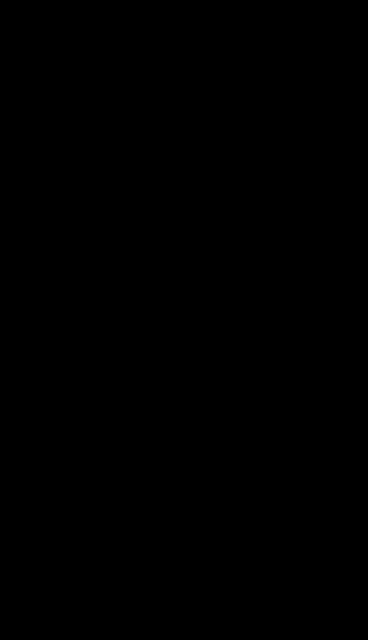

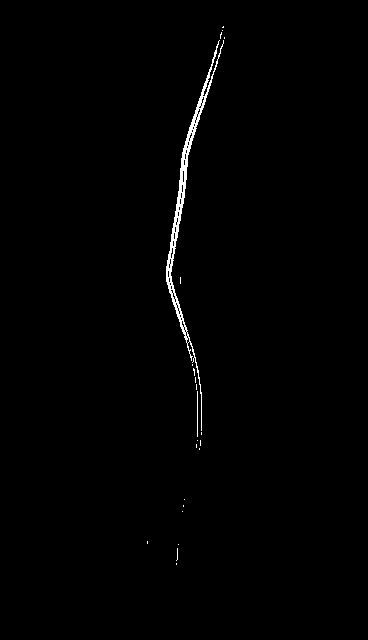

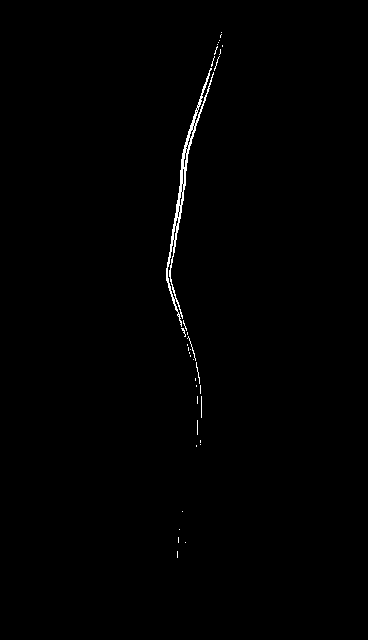

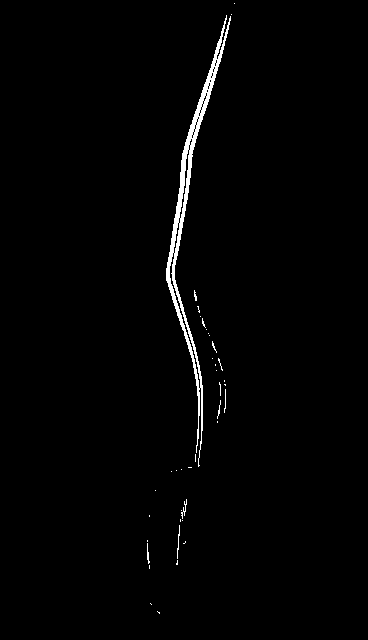

...

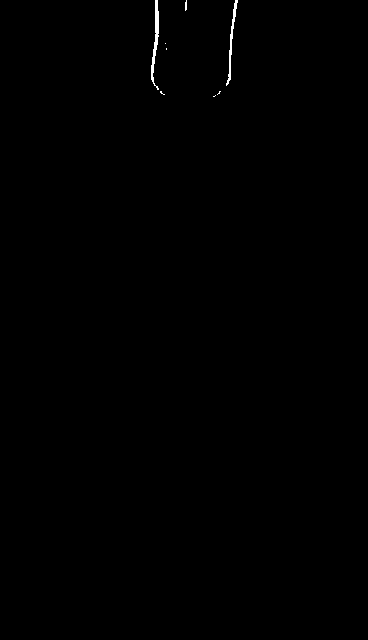

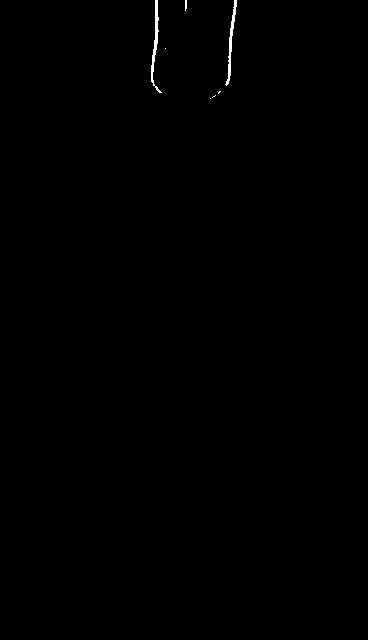

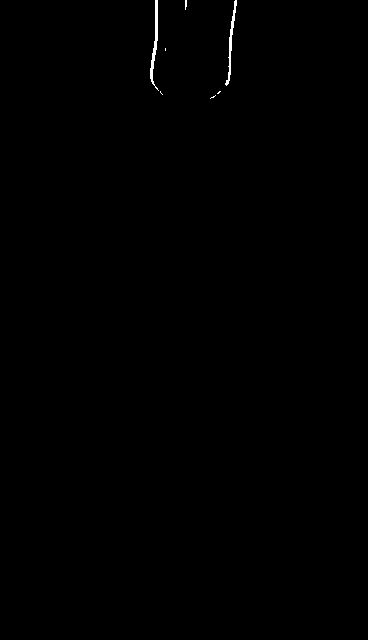

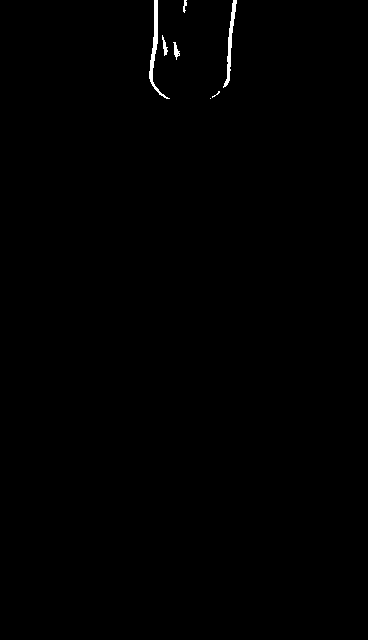

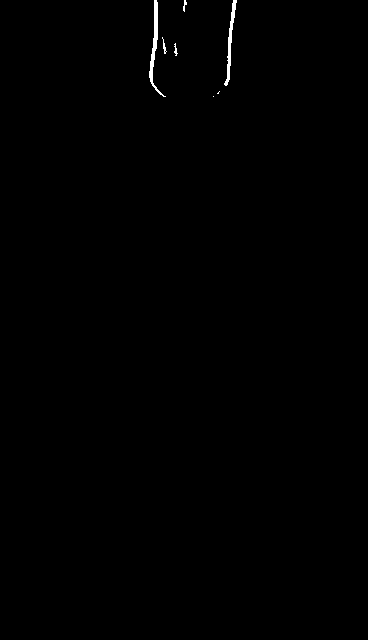

In [ ]:
#pour t-n et t+n
import cv2
import numpy as np

# Open the video
video = cv2.VideoCapture('/content/drive/MyDrive/folder/vid.mp4')  # Replace "nom_de_la_video.mp4" with your video file

# Number of frames to use for differentiation in the past and future
n_past_frames = 15
n_future_frames = 15

# Initialize background lists for the past and future frames
past_background_frames = []
future_background_frames = []

while True:
    ret, frame = video.read()
    if not ret:
        break

    # Convert the frame to grayscale
    frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Append the current frame to the list of background frames
    past_background_frames.append(frame_gray)
    future_background_frames.append(frame_gray)

    # If the lists exceed the specified number of frames, remove the oldest frames
    if len(past_background_frames) > n_past_frames:
        past_background_frames.pop(0)
    if len(future_background_frames) > n_future_frames:
        future_background_frames.pop(0)

    # Calculate the past and future backgrounds as the averages of the respective frame lists
    past_background_gray = np.mean(past_background_frames, axis=0).astype(np.uint8)
    future_background_gray = np.mean(future_background_frames, axis=0).astype(np.uint8)

    # Set a threshold for motion detection
    threshold = 15

    # Calculate the absolute difference between the current frame and the past background
    past_frame_diff = cv2.absdiff(frame_gray, past_background_gray)
    # Calculate the absolute difference between the future background and the current frame
    future_frame_diff = cv2.absdiff(future_background_gray, frame_gray)

    # Binarize the difference images
    _, binary_past_diff = cv2.threshold(past_frame_diff, threshold, 255, cv2.THRESH_BINARY)
    _, binary_future_diff = cv2.threshold(future_frame_diff, threshold, 255, cv2.THRESH_BINARY)

    final_diff = (binary_past_diff  & binary_future_diff)
    # Display the frame with motion regions for both past and future frames


    cv2_imshow(final_diff)

    if cv2.waitKey(30) & 0xFF == 27:  # Wait for 30 ms, if 'ESC' key is pressed, exit the loop
        break

# Release the video and close windows
video.release()
cv2.destroyAllWindows()


3-Maintenant, on implante la méthode « Adaptive Background
Substruction » ou on compare les 5 frame avant et les 5 frame apres avec consederation du fond initial avec une alpha:

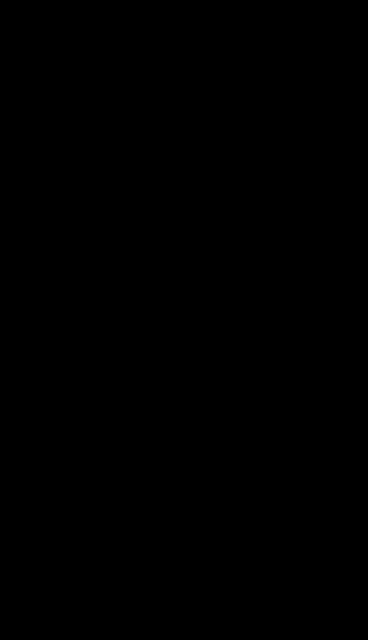

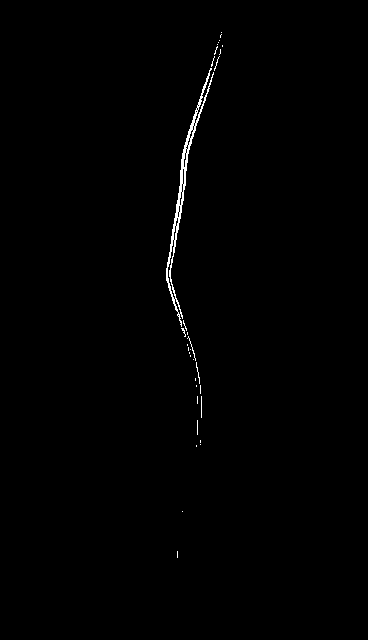

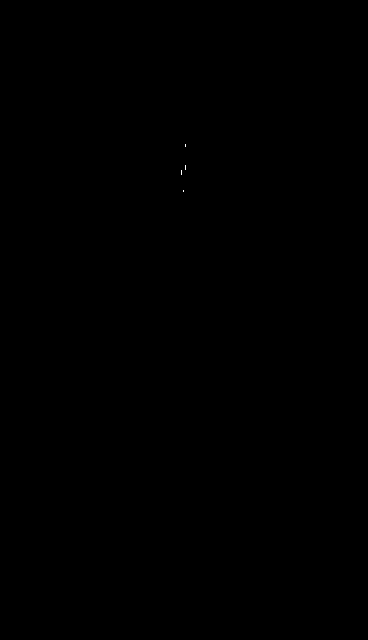

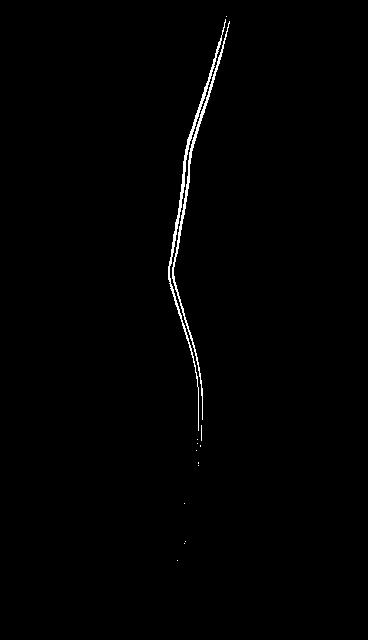

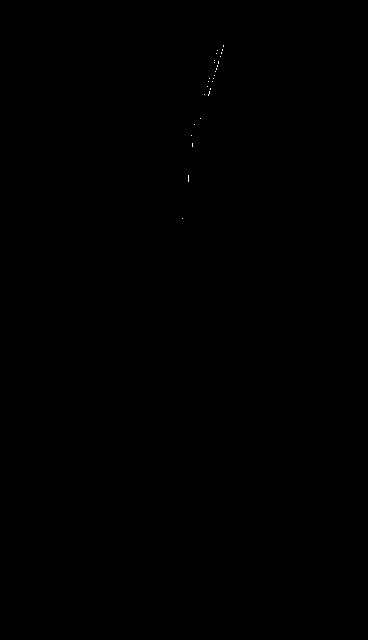

...

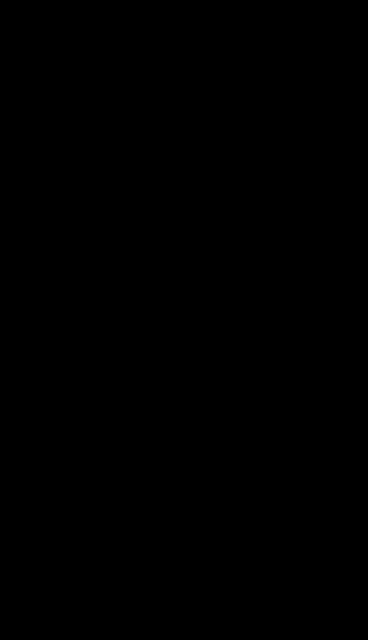

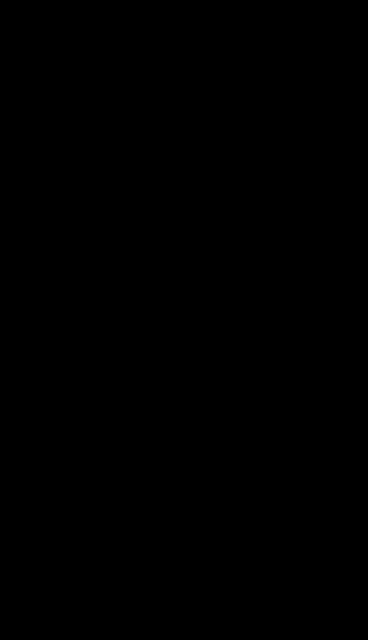

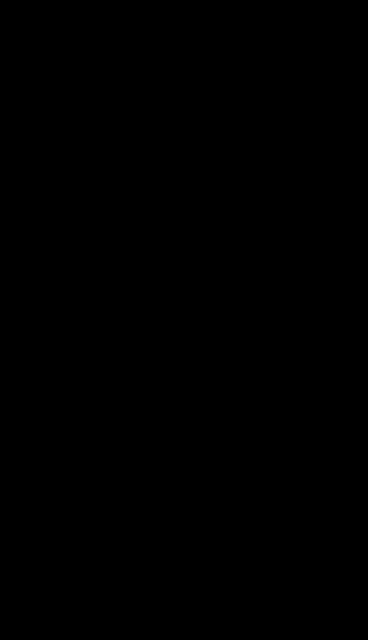

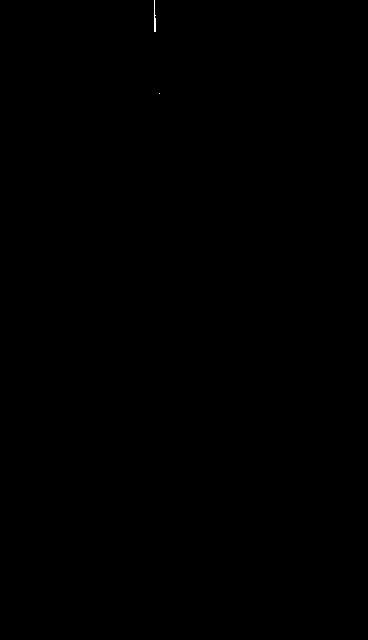

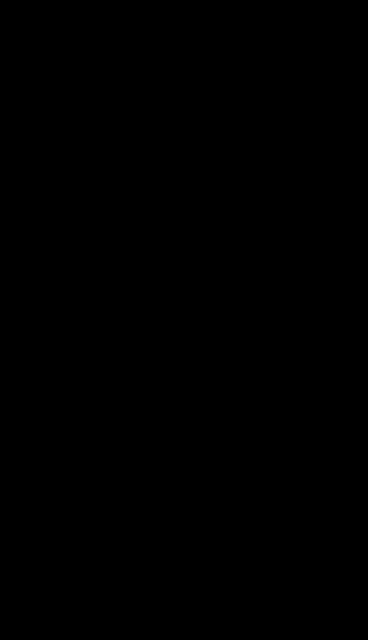

In [32]:
import cv2
import numpy as np

# Initialize alpha (learning rate) and threshold (T)
alpha = 0.5
T = 30

# Create a VideoCapture object to capture video from a camera or a file
cap = cv2.VideoCapture('/content/drive/MyDrive/folder/vid.mp4')  # Use 0 for camera input

# Read the first frame to initialize the background model
ret, bg_frame = cap.read()
bg_frame = cv2.cvtColor(bg_frame, cv2.COLOR_BGR2GRAY)

# Initialize the background model B(x, y, t) and D(x, y, t)
D = np.zeros_like(bg_frame)

while True:
    ret, frame = cap.read()
    if not ret:
        break

    # Convert the frame to grayscale
    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    # Update the background model using the algorithm
    bg_model = ((1 - alpha) * gray_frame + alpha * bg_frame).astype(np.uint8)
    bg_frame = bg_model.copy()
    # Calculate the absolute difference between the frame and the background model
    diff = cv2.absdiff(gray_frame, bg_model)

    # Apply the threshold to create a binary mask
    D = np.where(diff > T, 255, 0)

    cv2_imshow(D)

    if cv2.waitKey(30) & 0xFF == 27:
        break

cap.release()
cv2.destroyAllWindows()
